Milestone 1: Data Collection, Exploration, and Preprocessing

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# df = pd.read_csv(r'F:\depi\Final project\cardio_train.csv')
# df.head()

In [3]:
df = pd.read_csv("cardio_train.csv", sep=';')

In [4]:
# df.to_csv('cardio_train_separated.csv', index=False)

In [5]:
# df = pd.read_csv('cardio_train_separated.csv')
# df.head()

# note
## gender column : women -> 1 men ->2
## age column : in days should be converted to years /365
## ap_hi : upper blood pressure
## ap_lo : lower blood pressure
## height : in cm
## wight : in KG
## cholestrol : 1 normal - 2 above -3 well above
## glocuose : 1 normal - 2 above -3 well above

### Normalize the columns name to be intrtpreted easier

In [6]:
df=df.rename(columns={"gluc":"glucose","alco":"alcohol","active":"physically_active"})

In [7]:
df.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,glucose,smoke,alcohol,physically_active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 70000 non-null  int64  
 1   age                70000 non-null  int64  
 2   gender             70000 non-null  int64  
 3   height             70000 non-null  int64  
 4   weight             70000 non-null  float64
 5   ap_hi              70000 non-null  int64  
 6   ap_lo              70000 non-null  int64  
 7   cholesterol        70000 non-null  int64  
 8   glucose            70000 non-null  int64  
 9   smoke              70000 non-null  int64  
 10  alcohol            70000 non-null  int64  
 11  physically_active  70000 non-null  int64  
 12  cardio             70000 non-null  int64  
dtypes: float64(1), int64(12)
memory usage: 6.9 MB


In [9]:
len(df)

70000

In [10]:
df.isnull().sum()

id                   0
age                  0
gender               0
height               0
weight               0
ap_hi                0
ap_lo                0
cholesterol          0
glucose              0
smoke                0
alcohol              0
physically_active    0
cardio               0
dtype: int64

In [11]:
df.to_csv('cardio_train_new.csv', index=False)

In [12]:
df.drop('id', axis=1, inplace=True)
df['age_years'] = (df['age'] / 365).round().astype(int)
df.drop('age', axis=1, inplace=True)
df.head()

,gender,height,weight,ap_hi,ap_lo,cholesterol,glucose,smoke,alcohol,physically_active,cardio,age_years
0,2,168,62.0,110,80,1,1,0,0,1,0,50
1,1,156,85.0,140,90,3,1,0,0,1,1,55
2,1,165,64.0,130,70,3,1,0,0,0,1,52
3,2,169,82.0,150,100,1,1,0,0,1,1,48
4,1,156,56.0,100,60,1,1,0,0,0,0,48


# Calculate outliers in Numerical columns
height - weight - ap_hi ap_lo age_years

In [13]:
cols = ['height', 'weight', 'ap_hi', 'ap_lo', 'age_years']

for column in cols:
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    IQR = q3 - q1
    lower_bound = q1 - 1.5 * IQR
    upper_bound = q3 + 1.5 * IQR

    outliers_iqr = df[(df[column] > upper_bound) | (df[column] < lower_bound)]

    print(f"Outliers using IQR method for column: {column}")
    print(len(outliers_iqr))
    print("*" * 50)


Outliers using IQR method for column: height
519
**************************************************
Outliers using IQR method for column: weight
1819
**************************************************
Outliers using IQR method for column: ap_hi
1435
**************************************************
Outliers using IQR method for column: ap_lo
4632
**************************************************
Outliers using IQR method for column: age_years
4
**************************************************


###  we decided to keep the outliers to not affect the amount of data
### instead  Remove physiologically impossible values:

In [14]:
# Remove readings with systolic < 50 or > 250, diastolic < 30 or > 150
df = df[(df['ap_hi'] >= 50) & (df['ap_hi'] <= 250)]
df = df[(df['ap_lo'] >= 30) & (df['ap_lo'] <= 150)]

# Remove height < 140 cm or > 250 cm, weight < 20 kg or > 200 kg
df = df[(df['height'] >= 140) & (df['height'] <= 250)]
df = df[(df['weight'] >= 20) & (df['weight'] <= 200)]

df['bmi'] = df['weight'] / ((df['height'] / 100) ** 2)
# Remove unrealistic BMI values (typically 10-60)
df = df[(df['bmi'] >= 10) & (df['bmi'] <= 60)]

In [15]:
df.columns
for column in df.columns:
 print(column)
 print(df[column].unique())
 print ("***********")

gender
[2 1]
***********
height
[168 156 165 169 151 157 178 158 164 173 181 172 170 154 162 163 153 159
 166 155 160 175 171 152 187 148 179 180 188 185 167 183 174 176 161 184
 177 182 149 142 150 144 147 186 146 141 195 140 198 145 143 196 194 190
 189 192 250 191 193 207 197]
***********
weight
[ 62.    85.    64.    82.    56.    67.    93.    95.    71.    68.
  80.    60.    78.   112.    75.    52.    83.    69.    90.    45.
  65.    59.    66.    74.   105.    73.    55.    70.    72.    63.
  50.   107.    84.    77.    79.    76.    58.   115.    97.    53.
  57.    49.   110.    94.    92.    87.   103.    88.    99.   100.
  61.    48.    54.    51.    47.    91.   104.    81.    98.   108.
  89.   101.    86.    65.5  142.    96.    44.    41.   116.   200.
  64.8  120.   117.   125.   106.   114.   113.   129.   124.    42.
 123.   111.   102.   109.    46.   139.   150.   138.   131.    43.
  83.6  134.   106.5  121.    40.   141.   119.   126.   177.   122.
  62.3  11

### feature engineering - add columns to enrich the data for more Analysis

In [16]:
# Create pulse pressure (difference between systolic and diastolic)
df = df[df['ap_hi'] >= df['ap_lo']]
df['pulse_pressure'] = df['ap_hi'] - df['ap_lo']

# Create binary hypertension indicator
df['hypertension'] = ((df['ap_hi'] >= 130) | (df['ap_lo'] >= 90)).astype(int)

# Create risk score combining lifestyle factors
df['lifestyle_risk'] = df['smoke'] + (1 - df['physically_active']) + df['alcohol']

In [17]:
df.head()

,gender,height,weight,ap_hi,ap_lo,cholesterol,glucose,smoke,alcohol,physically_active,cardio,age_years,bmi,pulse_pressure,hypertension,lifestyle_risk
0,2,168,62.0,110,80,1,1,0,0,1,0,50,21.967120,30,0,0
1,1,156,85.0,140,90,3,1,0,0,1,1,55,34.927679,50,1,0
2,1,165,64.0,130,70,3,1,0,0,0,1,52,23.507805,60,1,1
3,2,169,82.0,150,100,1,1,0,0,1,1,48,28.710479,50,1,0
4,1,156,56.0,100,60,1,1,0,0,0,0,48,23.011177,40,0,1


In [18]:
df.to_csv('cleaned_data.csv', index=False)

# 2. Data Analysis and visualization Milestone 2

In [19]:
# corr_matrix = df.corr()
# sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='viridis', linewidths=0.5)
# plt.title('Correlation Matrix of Health Metrics', fontsize=16)
# plt.show()

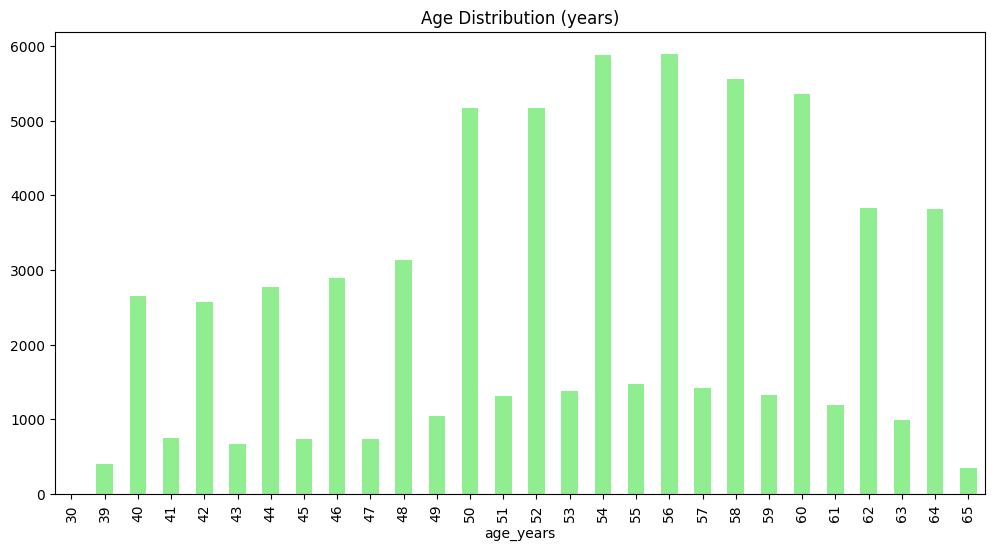

In [20]:
df['age_years'].value_counts().sort_index().plot(kind='bar', color='lightgreen', figsize=(12,6))
plt.title("Age Distribution (years)")
plt.show()

In [21]:
# df['bmi'].hist(bins=30, color='salmon', edgecolor='black', figsize=(10,5))
# plt.title("BMI Distribution")
# plt.show()

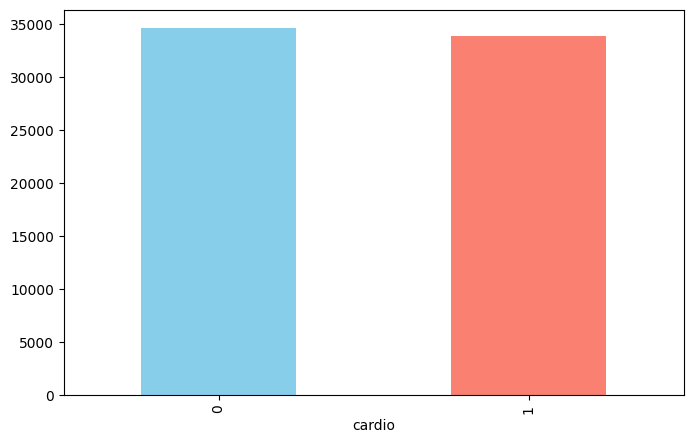

In [22]:
df['cardio'].value_counts().plot(kind='bar', color=['skyblue', 'salmon'], figsize=(8,5))
plt.show()

In [23]:
import plotly.graph_objects as go

# Calculate CVD prevalence percentage
cvd_percentage = (df['cardio'].value_counts(normalize=True) * 100)[1]

# Create the gauge chart
fig = go.Figure(go.Indicator(
    mode = "gauge+number",
    value = cvd_percentage,
    domain = {'x': [0, 1], 'y': [0, 1]},
    title = {'text': "Cardiovascular Disease Prevalence", 'font': {'size': 24}},
    gauge = {
        'axis': {'range': [0, 100], 'tickwidth': 1, 'tickcolor': "darkblue"},
        'bar': {'color': "darkblue"},
        'bgcolor': "white",
        'borderwidth': 2,
        'bordercolor': "gray",
        'steps': [
            {'range': [0, 50], 'color': 'lightgreen'},
            {'range': [50, 100], 'color': 'salmon'}
        ],
    }
))

# Update layout
fig.update_layout(
    paper_bgcolor = "white",
    font = {'color': "darkblue", 'family': "Arial"}
)

fig.show()

In [24]:
from plotly.subplots import make_subplots

# Calculate statistics
total_patients = len(df)
disease_rate = (df['cardio'].mean() * 100).round(1)
avg_age = df['age_years'].mean().round(1)
avg_systolic = df['ap_hi'].mean().round(1)
avg_diastolic = df['ap_lo'].mean().round(1)
hypertension_rate = (df['hypertension'].mean() * 100).round(1)
smoking_rate = (df['smoke'].mean() * 100).round(1)

# Create subplot grid for KPI cards
fig = make_subplots(
    rows=2, cols=4,
    specs=[[{'type': 'domain'}] * 4] * 2,

)

# Add indicators
fig.add_trace(go.Indicator(
    mode="number",
    value=total_patients,
    title={"text": "Total Patients"},
    domain={'row': 0, 'column': 0}
), row=1, col=1)

fig.add_trace(go.Indicator(
    mode="number+delta",
    value=disease_rate,
    number={'suffix': "%"},
    title={"text": "Disease Rate"},
    domain={'row': 0, 'column': 1}
), row=1, col=2)

fig.add_trace(go.Indicator(
    mode="number",
    value=avg_age,
    number={'suffix': " years"},
    title={"text": "Average Age"},
    domain={'row': 0, 'column': 2}
), row=1, col=3)

fig.add_trace(go.Indicator(
    mode="number",
    value=avg_systolic,
    number={'suffix': f"/{avg_diastolic} mmHg"},
    title={"text": "Average BP"},
    domain={'row': 1, 'column': 3}
), row=1, col=4)

fig.add_trace(go.Indicator(
    mode="number",
    value=hypertension_rate,
    number={'suffix': "%"},
    title={"text": "Hypertension Rate"},
    domain={'row': 1, 'column': 2}
), row=2, col=1)

fig.add_trace(go.Indicator(
    mode="number",
    value=smoking_rate,
    number={'suffix': "%"},
    title={"text": "Smoking Rate"},
    domain={'row': 1, 'column': 3}
), row=2, col=2)

# Update layout
fig.update_layout(
    grid={'rows': 2, 'columns': 4, 'pattern': "independent"},
    height=400,
    title_text="Key Health Statistics",
    title_x=0.5,
    showlegend=False,
    paper_bgcolor="white",
    font=dict(size=20, color="darkblue")
)

fig.show()

In [25]:
# Select relevant features
features = ['age_years', 'ap_hi', 'ap_lo', 'cholesterol', 'glucose', 'bmi',
            'pulse_pressure', 'smoke', 'physically_active', 'weight', 'cardio']
# Calculate correlation matrix for selected features
correlation_matrix = df[features].corr()
# Create heatmap
fig = go.Figure(data=go.Heatmap(
    z=correlation_matrix.values,
    x=features,
    y=features,
    text=correlation_matrix.round(2).astype(str).values,
    texttemplate='%{text}',
    textfont={"size": 10},
    colorscale='RdBu',
    zmid=0,
    colorbar=dict(title=dict(text='Correlation')),
    hovertemplate='%{x} vs %{y}<br>corr=%{z:.2f}<extra></extra>'
))
# Update layout
fig.update_layout(
    title='Feature Correlation Heatmap',
    title_x=0.5,
    width=900,
    height=800,
    xaxis_tickangle=-45,
    yaxis=dict(automargin=True),
    paper_bgcolor='white',
    plot_bgcolor='white'
)

fig.show()
# ...existing code...

In [26]:
# Features to rank (must exist in df)
features = ['ap_hi', 'age_years', 'glucose', 'cholesterol', 'bmi',
            'pulse_pressure', 'smoke', 'physically_active', 'weight']

# Keep only features present in df
features = [f for f in features if f in df.columns]

# Correlation with target
corr_with_cardio = df[features].corrwith(df['cardio'])

# Absolute correlations sorted (ascending for horizontal bar with largest on top)
abs_corr = corr_with_cardio.abs().sort_values(ascending=True)

# Color by sign (positive -> red, negative -> blue)
colors = ['red' if corr_with_cardio.loc[idx] > 0 else 'blue' for idx in abs_corr.index]

# Create horizontal bar chart
fig = go.Figure(go.Bar(
    x=abs_corr.values,
    y=abs_corr.index,
    orientation='h',
    marker=dict(color=colors),
    hovertemplate='%{y}<br>corr=%{customdata:.3f}<extra></extra>',
    customdata=corr_with_cardio.loc[abs_corr.index].values
))

fig.update_layout(
    title='Feature Importance (|Pearson correlation with CVD|)',
    xaxis_title='Absolute correlation coefficient',
    yaxis_title='Feature',
    height=500,
    margin=dict(l=150, r=40, t=60, b=40),
    paper_bgcolor='white',
    plot_bgcolor='white'
)

fig.show()



In [27]:
import plotly.express as px

# Columns for pairs plot
cols = ['age_years', 'ap_hi', 'ap_lo', 'bmi', 'pulse_pressure']

# Ensure required columns exist
cols = [c for c in cols if c in df.columns]
plot_df = df[cols + ['cardio']].copy()
plot_df['cardio_label'] = plot_df['cardio'].map({0: 'Healthy', 1: 'CVD'})

# Scatter matrix (pairs plot)
fig = px.scatter_matrix(
    plot_df,
    dimensions=cols,
    color='cardio_label',
    title='Scatter Plot Matrix — Pairwise Relationships (colored by outcome)',
    color_discrete_map={'Healthy': 'lightgreen', 'CVD': 'salmon'},
    labels={c: c.replace('_', ' ').title() for c in cols}
)

fig.update_traces(diagonal_visible=False, marker=dict(size=4, opacity=0.7))
fig.update_layout(width=900, height=900, legend_title_text='Outcome')
fig.show()

# Optional: Pulse pressure vs outcome (strip + box)
if 'pulse_pressure' in plot_df.columns:
    fig2 = px.strip(plot_df, x='cardio_label', y='pulse_pressure', color='cardio_label',
                    color_discrete_map={'Healthy':'lightgreen','CVD':'salmon'},
                    title='Pulse Pressure by Outcome', labels={'cardio_label':'Outcome','pulse_pressure':'Pulse Pressure (mmHg)'})
    fig2.update_traces(jitter=0.4, opacity=0.6)
    fig2.update_layout(showlegend=False, width=700, height=450)
    fig2.show()

In [28]:
#Make sure the basic columns are present
required = {'ap_hi', 'ap_lo', 'cardio'}
if not required.issubset(df.columns):
    raise RuntimeError(f"Missing columns: {required - set(df.columns)}")

# Blood pressure classification (taking the higher category between systolic and diastolic)
def bp_category(row):
    s, d = row['ap_hi'], row['ap_lo']
    if s < 120 and d < 80:
        return 'Normal'
    if 120 <= s < 130 and d < 80:
        return 'Elevated'
    # Stage 1: systolic 130-139 OR diastolic 80-89
    if (130 <= s < 140) or (80 <= d < 90):
        return 'Stage 1 HTN'
    # Stage 2: systolic >=140 OR diastolic >=90
    return 'Stage 2 HTN'

df['bp_category'] = df.apply(bp_category, axis=1)

# The order of the categories is fixed
cats = ['Normal', 'Elevated', 'Stage 1 HTN', 'Stage 2 HTN']
df['bp_category'] = pd.Categorical(df['bp_category'], categories=cats, ordered=True)

# Calculating numbers and patient ratios
counts = df.groupby('bp_category')['cardio'].value_counts().unstack(fill_value=0).reindex(cats).fillna(0).astype(int)
counts = counts.rename(columns={0: 'Healthy', 1: 'CVD'})

totals = counts.sum(axis=1)
disease_pct = (counts['CVD'] / totals * 100).round(1).fillna(0)

# Draw stacked horizontal bars
fig = go.Figure()
fig.add_trace(go.Bar(
    y=cats,
    x=counts['Healthy'],
    name='Healthy',
    orientation='h',
    marker_color='lightgreen',
    hovertemplate='Category: %{y}<br>Healthy: %{x}<extra></extra>'
))
fig.add_trace(go.Bar(
    y=cats,
    x=counts['CVD'],
    name='CVD',
    orientation='h',
    marker_color='salmon',
    hovertemplate='Category: %{y}<br>CVD: %{x}<br>Rate: %{customdata:.1f}%<extra></extra>',
    customdata=disease_pct.values.reshape(-1,1)
))

fig.update_layout(
    barmode='stack',
    title='Blood Pressure Categories and CVD Burden',
    xaxis_title='Number of Patients',
    yaxis_title='BP Category',
    height=450,
    paper_bgcolor='white',
    plot_bgcolor='white',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1)
)

# Add text for disease percentages to the right of each bar.
annotations = []
for i, cat in enumerate(cats):
    annotations.append(dict(
        x=totals.loc[cat] + max(totals.max()*0.02, 1),
        y=cat,
        text=f"{disease_pct.loc[cat]}% CVD",
        showarrow=False,
        font=dict(size=11, color='black'),
        xanchor='left',
        yanchor='middle'
    ))
fig.update_layout(annotations=annotations)

fig.show()


C:\Users\adham\AppData\Local\Temp\ipykernel_30912\298011108.py:26: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [29]:
import plotly.graph_objects as go

# Check if BMI column exists
if 'bmi' not in df.columns:
    raise ValueError("BMI column not found in DataFrame")

# Calculate BMI categories
def get_bmi_category(bmi):
    try:
        bmi_float = float(bmi)  # Convert to float
        if bmi_float < 18.5:
            return 'Underweight'
        elif bmi_float < 25:
            return 'Normal'
        elif bmi_float < 30:
            return 'Overweight'
        else:
            return 'Obese'
    except (ValueError, TypeError):
        return 'Unknown'  # Handle invalid BMI values

# Ensure BMI values are numeric
df['bmi'] = pd.to_numeric(df['bmi'], errors='coerce')

# Create BMI categories
df['bmi_category'] = df['bmi'].apply(get_bmi_category)

# ...rest of the code remains the same...

# Create BMI categories
df['bmi_category'] = df['bmi'].apply(get_bmi_category)

# Order categories
categories = ['Underweight', 'Normal', 'Overweight', 'Obese']
df['bmi_category'] = pd.Categorical(df['bmi_category'], categories=categories)

# Calculate counts and percentages
grouped = df.groupby('bmi_category')['cardio'].value_counts().unstack()
totals = grouped.sum(axis=1)
disease_pct = (grouped[1] / totals * 100).round(1)

# Create figure
fig = go.Figure()

# Add healthy cases
fig.add_trace(go.Bar(
    y=categories,
    x=grouped[0],
    name='Healthy',
    orientation='h',
    marker_color='lightgreen',
    hovertemplate='Category: %{y}<br>Healthy: %{x}<extra></extra>'
))

# Add disease cases
fig.add_trace(go.Bar(
    y=categories,
    x=grouped[1],
    name='CVD',
    orientation='h',
    marker_color='salmon',
    hovertemplate='Category: %{y}<br>CVD: %{x}<br>Rate: %{customdata:.1f}%<extra></extra>',
    customdata=disease_pct.values.reshape(-1,1)
))

# Update layout
fig.update_layout(
    barmode='stack',
    title='BMI Categories and CVD Risk',
    xaxis_title='Number of Patients',
    yaxis_title='BMI Category',
    height=450,
    paper_bgcolor='white',
    plot_bgcolor='white',
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1)
)

# Add percentage annotations
annotations = []
for i, cat in enumerate(categories):
    annotations.append(dict(
        x=totals.loc[cat] + max(totals.max()*0.02, 1),
        y=cat,
        text=f"{disease_pct.loc[cat]}% CVD",
        showarrow=False,
        font=dict(size=11, color='black'),
        xanchor='left',
        yanchor='middle'
    ))
fig.update_layout(annotations=annotations)

fig.show()

C:\Users\adham\AppData\Local\Temp\ipykernel_30912\1410936957.py:38: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [30]:
# Create metabolic risk score (combining cholesterol and glucose)
df['metabolic_score'] = df['cholesterol'] + df['glucose']

# Split data into healthy and CVD groups
healthy_scores = df[df['cardio'] == 0]['metabolic_score']
cvd_scores = df[df['cardio'] == 1]['metabolic_score']

# Create histogram traces
fig = go.Figure()

# Add histogram for healthy patients
fig.add_trace(go.Histogram(
    x=healthy_scores,
    name='Healthy',
    nbinsx=30,
    opacity=0.7,
    marker_color='lightgreen',
    histnorm='probability'
))

# Add histogram for CVD patients
fig.add_trace(go.Histogram(
    x=cvd_scores,
    name='CVD',
    nbinsx=30,
    opacity=0.7,
    marker_color='salmon',
    histnorm='probability'
))

# Add KDE curves
for scores, color, name in [(healthy_scores, 'darkgreen', 'Healthy KDE'),
                          (cvd_scores, 'red', 'CVD KDE')]:
    kde = np.histogram(scores, bins=50, density=True)
    x = (kde[1][:-1] + kde[1][1:]) / 2
    fig.add_trace(go.Scatter(
        x=x,
        y=kde[0],
        name=name,
        line=dict(color=color, width=2),
        opacity=0.8
    ))

# Update layout
fig.update_layout(
    title='Metabolic Risk Score Distribution by Cardiovascular Disease Status',
    xaxis_title='Metabolic Risk Score (Cholesterol + Glucose)',
    yaxis_title='Probability',
    barmode='overlay',
    height=500,
    width=900,
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    paper_bgcolor='white',
    plot_bgcolor='white'
)

# Add statistical annotations
healthy_mean = healthy_scores.mean().round(2)
cvd_mean = cvd_scores.mean().round(2)
fig.add_annotation(
    text=f'Healthy Mean: {healthy_mean}<br>CVD Mean: {cvd_mean}',
    xref="paper", yref="paper",
    x=0.02, y=0.98,
    showarrow=False,
    font=dict(size=12)
)

fig.show()

In [31]:
# Create age groups
df['age_group'] = pd.cut(df['age_years'],
                        bins=[0, 40, 50, 60, 70, 100],
                        labels=['30-40', '40-50', '50-60', '60-70', '70+'])

# Calculate statistics for each age group
age_stats = df.groupby('age_group').agg({
    'cardio': ['count', 'sum']
}).reset_index()

age_stats.columns = ['age_group', 'total_count', 'disease_count']
age_stats['prevalence'] = (age_stats['disease_count'] / age_stats['total_count'] * 100).round(1)

# Calculate confidence intervals (95%)
z = 1.96  # 95% confidence level
age_stats['ci'] = z * np.sqrt((age_stats['prevalence'] * (100 - age_stats['prevalence'])) / age_stats['total_count'])

# Create figure
fig = go.Figure()

# Add prevalence line
fig.add_trace(go.Scatter(
    x=age_stats['age_group'],
    y=age_stats['prevalence'],
    mode='lines+markers',
    name='CVD Prevalence',
    line=dict(color='darkblue', width=2),
    marker=dict(size=8),
    hovertemplate='Age: %{x}<br>Prevalence: %{y:.1f}%<br>n=%{customdata[0]}<extra></extra>',
    customdata=age_stats[['total_count', 'disease_count']].values
))

# Add confidence interval
fig.add_trace(go.Scatter(
    x=age_stats['age_group'],
    y=age_stats['prevalence'] + age_stats['ci'],
    mode='lines',
    line=dict(width=0),
    showlegend=False,
    hoverinfo='skip'
))

fig.add_trace(go.Scatter(
    x=age_stats['age_group'],
    y=age_stats['prevalence'] - age_stats['ci'],
    mode='lines',
    line=dict(width=0),
    fillcolor='rgba(0, 0, 255, 0.2)',
    fill='tonexty',
    name='95% CI',
    hoverinfo='skip'
))

# Add trend line
z = np.polyfit(range(len(age_stats)), age_stats['prevalence'], 2)
p = np.poly1d(z)
trend_y = p(range(len(age_stats)))

fig.add_trace(go.Scatter(
    x=age_stats['age_group'],
    y=trend_y,
    mode='lines',
    line=dict(color='red', dash='dash'),
    name='Trend',
    hoverinfo='skip'
))

# Update layout
fig.update_layout(
    title='CVD Prevalence by Age Group',
    xaxis_title='Age Group (years)',
    yaxis_title='Disease Prevalence (%)',
    height=500,
    width=900,
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    paper_bgcolor='white',
    plot_bgcolor='white',
    yaxis=dict(
        gridcolor='lightgray',
        range=[0, max(age_stats['prevalence'] + age_stats['ci']) * 1.1]
    ),
    xaxis=dict(gridcolor='lightgray')
)

# Add annotations for key statistics
max_prev_idx = age_stats['prevalence'].idxmax()
fig.add_annotation(
    text=f"Peak prevalence: {age_stats['prevalence'][max_prev_idx]:.1f}%<br>in {age_stats['age_group'][max_prev_idx]}",
    xref="paper", yref="paper",
    x=0.02, y=0.98,
    showarrow=False,
    font=dict(size=12),
    bgcolor='rgba(255, 255, 255, 0.8)'
)

fig.show()

C:\Users\adham\AppData\Local\Temp\ipykernel_30912\2204798267.py:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [32]:
import plotly.express as px

# Create figure
fig = px.scatter(df,
    x='age_years',
    y='ap_hi',
    color='cardio',
    size='pulse_pressure',
    color_discrete_map={0: 'lightgreen', 1: 'salmon'},
    labels={
        'age_years': 'Age (years)',
        'ap_hi': 'Systolic Blood Pressure (mmHg)',
        'cardio': 'CVD Status',
        'pulse_pressure': 'Pulse Pressure'
    },
    title='Age vs Systolic Blood Pressure',
    size_max=15,
    opacity=0.6
)

# Add trend lines
for cvd_status in [0, 1]:
    mask = df['cardio'] == cvd_status
    coeffs = np.polyfit(df[mask]['age_years'], df[mask]['ap_hi'], 2)
    poly = np.poly1d(coeffs)

    x_range = np.linspace(df['age_years'].min(), df['age_years'].max(), 100)
    y_pred = poly(x_range)

    name = 'Trend (Healthy)' if cvd_status == 0 else 'Trend (CVD)'
    color = 'darkgreen' if cvd_status == 0 else 'red'

    fig.add_trace(
        px.line(x=x_range, y=y_pred,
                labels={'x': 'Age', 'y': 'Systolic BP'})
        .data[0]
        .update(line=dict(color=color, dash='dash'), name=name)
    )

# Update layout
fig.update_layout(
    width=900,
    height=600,
    paper_bgcolor='white',
    plot_bgcolor='white',
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    hovermode='closest'
)

# Update axes
fig.update_xaxes(
    gridcolor='lightgray',
    zeroline=False
)
fig.update_yaxes(
    gridcolor='lightgray',
    zeroline=False
)

# Add hover template
fig.update_traces(
    hovertemplate="""
    Age: %{x} years<br>
    Systolic BP: %{y} mmHg<br>
    Pulse Pressure: %{marker.size} mmHg<br>
    <extra></extra>
    """
)

# Calculate and add correlation annotations
corr_all = df['age_years'].corr(df['ap_hi']).round(3)
corr_healthy = df[df['cardio']==0]['age_years'].corr(df[df['cardio']==0]['ap_hi']).round(3)
corr_cvd = df[df['cardio']==1]['age_years'].corr(df[df['cardio']==1]['ap_hi']).round(3)

fig.add_annotation(
    text=f'Correlations:<br>Overall: {corr_all}<br>Healthy: {corr_healthy}<br>CVD: {corr_cvd}',
    xref="paper", yref="paper",
    x=0.02, y=0.98,
    showarrow=False,
    font=dict(size=12),
    bgcolor='rgba(255, 255, 255, 0.8)',
    bordercolor='gray',
    borderwidth=1
)

fig.show()

In [33]:
df.head()

,gender,height,weight,ap_hi,ap_lo,cholesterol,glucose,smoke,alcohol,physically_active,cardio,age_years,bmi,pulse_pressure,hypertension,lifestyle_risk,bp_category,bmi_category,metabolic_score,age_group
0,2,168,62.0,110,80,1,1,0,0,1,0,50,21.967120,30,0,0,Stage 1 HTN,Normal,2,40-50
1,1,156,85.0,140,90,3,1,0,0,1,1,55,34.927679,50,1,0,Stage 2 HTN,Obese,4,50-60
2,1,165,64.0,130,70,3,1,0,0,0,1,52,23.507805,60,1,1,Stage 1 HTN,Normal,4,50-60
3,2,169,82.0,150,100,1,1,0,0,1,1,48,28.710479,50,1,0,Stage 2 HTN,Overweight,2,40-50
4,1,156,56.0,100,60,1,1,0,0,0,0,48,23.011177,40,0,1,Normal,Normal,2,40-50


In [34]:
fig13 = make_subplots(
    rows=1, cols=3,
    subplot_titles=('Systolic Blood Pressure', 'Diastolic Blood Pressure', 'Pulse Pressure')
)

# Systolic BP
for cardio_status, color in [(0, '#27ae60'), (1, '#e74c3c')]:
    subset = df[df['cardio'] == cardio_status]
    label = 'Healthy' if cardio_status == 0 else 'CVD'

    fig13.add_trace(
        go.Box(
            y=subset['ap_hi'],
            name=label,
            marker_color=color,
            boxmean='sd',
            showlegend=(True if cardio_status == 0 else False),
            hovertemplate='<b>%{fullData.name}</b><br>Value: %{y}<extra></extra>'
        ),
        row=1, col=1
    )

# Diastolic BP
for cardio_status, color in [(0, '#27ae60'), (1, '#e74c3c')]:
    subset = df[df['cardio'] == cardio_status]
    label = 'Healthy' if cardio_status == 0 else 'CVD'

    fig13.add_trace(
        go.Box(
            y=subset['ap_lo'],
            name=label,
            marker_color=color,
            boxmean='sd',
            showlegend=False,
            hovertemplate='<b>%{fullData.name}</b><br>Value: %{y}<extra></extra>'
        ),
        row=1, col=2
    )

# Pulse Pressure
for cardio_status, color in [(0, '#27ae60'), (1, '#e74c3c')]:
    subset = df[df['cardio'] == cardio_status]
    label = 'Healthy' if cardio_status == 0 else 'CVD'

    fig13.add_trace(
        go.Box(
            y=subset['pulse_pressure'],
            name=label,
            marker_color=color,
            boxmean='sd',
            showlegend=False,
            hovertemplate='<b>%{fullData.name}</b><br>Value: %{y}<extra></extra>'
        ),
        row=1, col=3
    )

fig13.update_yaxes(title_text="mmHg", row=1, col=1)
fig13.update_yaxes(title_text="mmHg", row=1, col=2)
fig13.update_yaxes(title_text="mmHg", row=1, col=3)

fig13.update_layout(
    title_text="Blood Pressure Distribution Comparison: Healthy vs. CVD Patients",
    height=500,
    template='plotly_white',
    showlegend=True
)

fig13.show()

Machine learning

In [35]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.feature_selection import f_classif

from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from scipy.stats import randint, uniform
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import confusion_matrix, classification_report



In [36]:
df = pd.read_csv("cleaned_data.csv")

In [37]:
df['health_index'] = (df['physically_active'] * 1) - (df['smoke'] * 0.5) - (df['alcohol'] * 0.5)
df['cholesterol_gluc_interaction'] = df['cholesterol'] * df['glucose']

In [38]:
featuers=['gender','height' ,'weight', 'ap_hi', 'ap_lo', 'cholesterol', 'glucose', 'smoke',
       'alcohol', 'physically_active', 'age_years', 'bmi', 'pulse_pressure',
       'health_index', 'cholesterol_gluc_interaction','hypertension']

In [39]:
target = 'cardio'

In [40]:
def IQR(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)

    IQR = Q3 - Q1

    min_v = Q1 - 1.5 * IQR
    max_v = Q3 + 1.5 * IQR

    return series.clip(lower=min_v, upper=max_v)

 Outlier Treatment using IQR (Interquartile Range) method
  Apply outlier removal separately for each target class to preserve class-specific distributions
 Exclude categorical and engineered features that shouldn't undergo outlier treatment
 Process only raw numerical features (age, height, weight, blood pressure)

In [41]:
exclude = ['glucose','alcohol','smoke','cholesterol','physically_active','hypertension','lifestyle_risk','health_index','cholesterol_gluc_interaction']

for num_feature in [f for f in featuers if f not in exclude]:
    for target_category in df[target].unique():
       mask = df[target] == target_category
       df.loc[mask, num_feature] = IQR(df.loc[mask, num_feature])



C:\Users\adham\AppData\Local\Temp\ipykernel_30912\1495641000.py:6: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[168. 156. 151. ... 159. 168. 170.]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.



In [42]:
X = df.drop('cardio', axis=1)
y = df['cardio']


X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.25, random_state=42, stratify=y
)

continuous_features = ['height','weight','ap_hi','ap_lo','age_years','bmi','pulse_pressure']

scaler = StandardScaler()


X_train[continuous_features] = scaler.fit_transform(X_train[continuous_features])


X_test[continuous_features] = scaler.transform(X_test[continuous_features])


In [43]:
print(f"{X_train.shape= }")
print(f"{y_train.shape= }")
print(f"{X_test.shape= }")
print(f"{y_test.shape= }")

X_train.shape= (51378, 17)
y_train.shape= (51378,)
X_test.shape= (17127, 17)
y_test.shape= (17127,)


In [44]:
y_train.value_counts()

cardio
0    25958
1    25420
Name: count, dtype: int64

In [ ]:
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Random Forest": RandomForestClassifier(random_state=42),
    "Gradient Boosting": GradientBoostingClassifier(random_state=42),
     "Decision Tree": DecisionTreeClassifier(random_state=42),
     "XGBoost": XGBClassifier(random_state=42 )
}

results = []

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    # Predict probabilities for the positive class (1)
    # Only if the model supports the predict_proba method
    y_prob = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else None
    # Train,Test Accuracy
    train_acc = model.score(X_train, y_train)
    test_acc = model.score(X_test, y_test)
    print("Training Model:")
    print(f"{name} is training")
    #print(y_prob)
    results.append({
        "Model": name,
        "Accuracy": accuracy_score(y_test, y_pred),
        "Precision": precision_score(y_test, y_pred),
        "Recall": recall_score(y_test, y_pred),
        "F1": f1_score(y_test, y_pred),
        # ROC-AUC measures model’s ability to distinguish between classes
        "ROC-AUC": roc_auc_score(y_test, y_prob) if y_prob is not None else np.nan
    })

results_df = pd.DataFrame(results)
print("Model Performance Comparison:\n")
print(results_df)

Logistic Regression : Train Accuracy: 0.777 | Test Accuracy: 0.785
Random Forest : Train Accuracy: 0.978 | Test Accuracy: 0.839
Gradient Boosting : Train Accuracy: 0.853 | Test Accuracy: 0.857
Decision Tree : Train Accuracy: 0.978 | Test Accuracy: 0.814
XGBoost : Train Accuracy: 0.876 | Test Accuracy: 0.858
Model Performance Comparison:

                 Model  Accuracy  Precision    Recall        F1   ROC-AUC
0  Logistic Regression  0.784667   0.855150  0.679962  0.757560  0.841980
1        Random Forest  0.838851   0.865532  0.798324  0.830571  0.923966
2    Gradient Boosting  0.856776   0.961521  0.740146  0.836434  0.939981
3        Decision Tree  0.814036   0.817200  0.803989  0.810541  0.822355
4              XGBoost  0.858469   0.912013  0.790182  0.846737  0.942212


 Hyperparameter Tuning: Random Forest with RandomizedSearchCV
 Use RandomizedSearchCV to efficiently explore hyperparameter space
 Search across 40 random combinations of parameters with 5-fold cross-validation
Optimize for accuracy score using all available CPU cores (n_jobs=-1)

In [46]:
rf = RandomForestClassifier(random_state=42)

param_dist_rf = {
    'n_estimators': randint(100,300),
    'max_depth': randint(5, 20),
    'min_samples_split': randint(2, 20),
    'min_samples_leaf': randint(1, 5),
    'max_features': ['sqrt', 'log2'],
    'bootstrap': [True, False]
}

random_search_rf = RandomizedSearchCV(
    rf, param_distributions=param_dist_rf,
    n_iter=40, cv=5, scoring='recall', n_jobs=-1, random_state=42
)
random_search_rf.fit(X_train, y_train)
print("Random Forest best params:", random_search_rf.best_params_)


Random Forest best params: {'bootstrap': True, 'max_depth': 19, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 108}


In [47]:

gb = GradientBoostingClassifier(random_state=42)

param_dist_gb = {
    'n_estimators': randint(100, 300),
    'learning_rate': uniform(0.01, 0.2),
    'max_depth': randint(3, 7),
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 5),
    'subsample': uniform(0.7, 0.3)
}

random_search_gb = RandomizedSearchCV(
    gb, param_distributions=param_dist_gb,
    n_iter=40, cv=5, scoring='recall', n_jobs=-1, random_state=42
)
random_search_gb.fit(X_train, y_train)
print("Gradient Boosting best params:", random_search_gb.best_params_)


KeyboardInterrupt: 

In [ ]:
log_reg = LogisticRegression(max_iter=1000, solver='lbfgs')

param_dist_lr = {
    'C': uniform(0.01, 10)
}

random_search_lr = RandomizedSearchCV(
    log_reg, param_distributions=param_dist_lr,
    n_iter=30, cv=5, scoring='recall', n_jobs=-1, random_state=42
)
random_search_lr.fit(X_train, y_train)
print("Logistic Regression best params:", random_search_lr.best_params_)


Logistic Regression best params: {'C': np.float64(0.5908361216819946)}


In [ ]:
xgb = XGBClassifier(eval_metric='logloss',random_state=42, use_label_encoder=False)

param_dist_xgb = {
    'n_estimators': randint(100, 300),
    'max_depth': randint(3, 10),
    'learning_rate': uniform(0.01, 0.9),
    'subsample': uniform(0.7, 0.3),
    'colsample_bytree': uniform(0.7, 0.3),
    'gamma': uniform(0, 5),
    'reg_lambda': uniform(0, 5),
    'reg_alpha': uniform(0, 5)
}

random_search_xgb = RandomizedSearchCV(
    xgb, param_distributions=param_dist_xgb,
    n_iter=40, cv=5, scoring='recall', n_jobs=-1, random_state=42
)
random_search_xgb.fit(X_train, y_train)
print("XGBoost best params:", random_search_xgb.best_params_)


/usr/local/lib/python3.12/dist-packages/xgboost/training.py:199: UserWarning:

[23:19:11] WARNING: /workspace/src/learner.cc:790: 
Parameters: { "use_label_encoder" } are not used.




XGBoost best params: {'colsample_bytree': np.float64(0.7913841307520112), 'gamma': np.float64(0.48836057003191935), 'learning_rate': np.float64(0.6258097238609412), 'max_depth': 9, 'n_estimators': 287, 'reg_alpha': np.float64(0.6101911742238941), 'reg_lambda': np.float64(2.475884550556351), 'subsample': np.float64(0.7103165563345655)}


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform

# موديل Decision Tree
dt = DecisionTreeClassifier(random_state=42)


param_dist_dt = {
    'max_depth': randint(3, 20),
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 5),
    'max_features': ['sqrt', 'log2', None],
    'criterion': ['gini', 'entropy']
}

# RandomizedSearchCV
random_search_dt = RandomizedSearchCV(
    dt,
    param_distributions=param_dist_dt,
    n_iter=40,      # عدد التجارب العشوائية
    cv=5,           # cross-validation
    scoring='recall',
    n_jobs=-1,
    random_state=42
)


random_search_dt.fit(X_train, y_train)

# أفضل المعلمات
print("Decision Tree best params:", random_search_dt.best_params_)





Decision Tree best params: {'criterion': 'gini', 'max_depth': 15, 'max_features': None, 'min_samples_leaf': 3, 'min_samples_split': 6}


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

best_models = {
    "Logistic Regression": random_search_lr.best_estimator_,
    "Random Forest": random_search_rf.best_estimator_,
    "Gradient Boosting": random_search_gb.best_estimator_,
    "XGBoost": random_search_xgb.best_estimator_,
    "Desicion tree":random_search_dt.best_estimator_
}

results = []
for name, model in best_models.items():
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]
     # Train,Test Accuracy
    train_acc = model.score(X_train, y_train)
    test_acc = model.score(X_test, y_test)
    print(f"{name} : Train Accuracy: {train_acc:.3f} | Test Accuracy: {test_acc:.3f}")
    results.append({
        "Model": name,
        "Accuracy": accuracy_score(y_test, y_pred),
        "Precision": precision_score(y_test, y_pred),
        "Recall": recall_score(y_test, y_pred),
        "F1": f1_score(y_test, y_pred),
        "ROC-AUC": roc_auc_score(y_test, y_prob)
    })


import pandas as pd
results_df = pd.DataFrame(results)
print(results_df.sort_values(by='Recall', ascending=False))


Logistic Regression : Train Accuracy: 0.777 | Test Accuracy: 0.785
Random Forest : Train Accuracy: 0.885 | Test Accuracy: 0.859
Gradient Boosting : Train Accuracy: 0.896 | Test Accuracy: 0.856
XGBoost : Train Accuracy: 0.950 | Test Accuracy: 0.834
Desicion tree : Train Accuracy: 0.862 | Test Accuracy: 0.854
                 Model  Accuracy  Precision    Recall        F1   ROC-AUC
4        Desicion tree  0.854148   0.888052  0.806939  0.845555  0.937988
3              XGBoost  0.834180   0.852389  0.804107  0.827544  0.927127
2    Gradient Boosting  0.856309   0.903070  0.794902  0.845541  0.940599
1        Random Forest  0.858644   0.929474  0.772953  0.844018  0.940618
0  Logistic Regression  0.784843   0.855531  0.679962  0.757709  0.841979


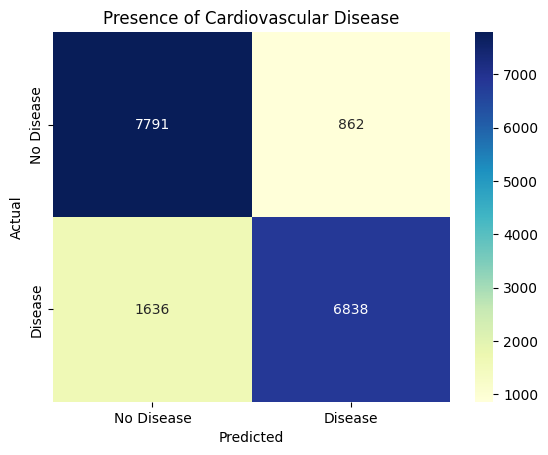

In [ ]:
cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu',
            xticklabels=['No Disease', 'Disease'],
            yticklabels=['No Disease', 'Disease'])
plt.title('Presence of Cardiovascular Disease')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score

threshold_results = []

for name, model in best_models.items():
    y_prob = model.predict_proba(X_test)[:, 1]
    thresholds = np.arange(0.0, 1.0, 0.01)

    best_threshold = 0.5
    best_f1 = 0
    best_metrics = {}


    for t in thresholds:
        y_pred = (y_prob >= t).astype(int)
        f1 = f1_score(y_test, y_pred)
        if f1 > best_f1:
            best_f1 = f1
            best_threshold = t
            best_metrics = {
                "Accuracy": accuracy_score(y_test, y_pred),
                "Recall": recall_score(y_test, y_pred),
                "Precision": precision_score(y_test, y_pred),
                "F1": f1,
                "ROC-AUC": roc_auc_score(y_test, y_prob)
            }

    threshold_results.append({
        "Model": name,
        "Best_Threshold": best_threshold,
        **best_metrics
    })


results_df = pd.DataFrame(threshold_results)
print("✅ Best Threshold for Each Model (Based on Highest F1 Score):\n")
print(results_df.sort_values(by="F1", ascending=False).round(3))


✅ Best Threshold for Each Model (Based on Highest F1 Score):

                 Model  Best_Threshold  Accuracy  Recall  Precision     F1  \
1        Random Forest            0.43     0.858   0.813      0.890  0.850   
2    Gradient Boosting            0.44     0.855   0.826      0.874  0.849   
4        Desicion tree            0.48     0.854   0.809      0.886  0.846   
3              XGBoost            0.59     0.840   0.783      0.880  0.829   
0  Logistic Regression            0.45     0.778   0.725      0.807  0.763   

   ROC-AUC  
1    0.941  
2    0.941  
4    0.938  
3    0.927  
0    0.842  



 Best model: Gradient Boosting
Best threshold: 0.44


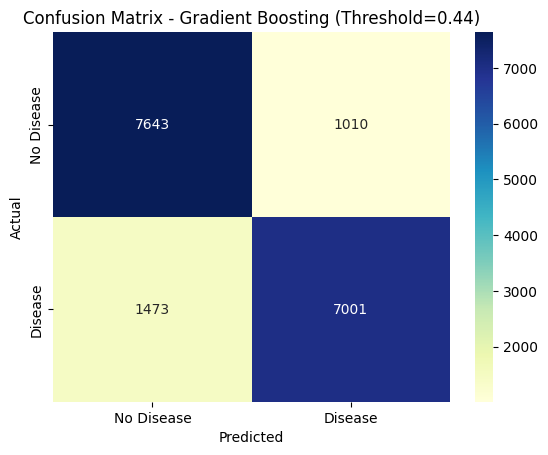


Classification Report:

              precision    recall  f1-score   support

           0       0.84      0.88      0.86      8653
           1       0.87      0.83      0.85      8474

    accuracy                           0.86     17127
   macro avg       0.86      0.85      0.85     17127
weighted avg       0.86      0.86      0.85     17127



In [ ]:

best_thresholds = results_df.set_index("Model")["Best_Threshold"].to_dict()

best_model_name = "Gradient Boosting"
best_model = best_models[best_model_name]
best_threshold = best_thresholds[best_model_name]

print(f"\n Best model: {best_model_name}")
print(f"Best threshold: {best_threshold:.2f}")


y_prob = best_model.predict_proba(X_test)[:, 1]
y_pred_final = (y_prob >= best_threshold).astype(int)



cm = confusion_matrix(y_test, y_pred_final)
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu',
            xticklabels=['No Disease', 'Disease'],
            yticklabels=['No Disease', 'Disease'])
plt.title(f'Confusion Matrix - {best_model_name} (Threshold={best_threshold:.2f})')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("\nClassification Report:\n")
print(classification_report(y_test, y_pred_final))


In [ ]:
import numpy as np
import pandas as pd
import joblib, json, os

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


In [ ]:
features = [
    'gender','height','weight', 'ap_hi', 'ap_lo', 'cholesterol','glucose',
    'smoke', 'alcohol', 'physically_active',
    'age_years', 'bmi', 'pulse_pressure', 'health_index',
    'cholesterol_gluc_interaction','hypertension'
]

In [ ]:
preprocessor = ColumnTransformer(
    transformers=[
        ("scale", StandardScaler(), features)
    ],
    remainder="drop"
)

In [ ]:
models = {
    "Logistic Regression": random_search_lr.best_estimator_,
    "Random Forest": random_search_rf.best_estimator_,
    "Gradient Boosting": random_search_gb.best_estimator_,
    "XGBoost": random_search_xgb.best_estimator_,
    "Decision Tree": random_search_dt.best_estimator_
}

needs_scaling = ["Logistic Regression"]

In [ ]:
trained_pipelines = {}

print("=" * 80)
print("TRAINING MODELS IN PIPELINES")
print("=" * 80)

for name, model in models.items():
    print(f"\nTraining {name}...")

    if name in needs_scaling:
        pipeline = Pipeline([
            ("preprocessing", preprocessor),
            ("model", model)
        ])
    else:
        pipeline = Pipeline([
            ("model", model)
        ])

    pipeline.fit(X_train[features], y_train)
    trained_pipelines[name] = pipeline
    print(f"  ✓ Pipeline trained successfully")

print("\nAll models trained inside pipelines\n")


Training model: Logistic Regression
Training model: Random Forest
Training model: Gradient Boosting
Training model: Decision Tree
Training model: XGBoost


In [ ]:
print("=" * 80)
print("OPTIMIZING THRESHOLDS BASED ON F1 SCORE")
print("=" * 80)

threshold_results = []

for name, pipeline in trained_pipelines.items():
    print(f"\nOptimizing {name}...")

    # Get probabilities using the pipeline
    y_prob = pipeline.predict_proba(X_test[features])[:, 1]

    best_t = 0.5
    best_f1 = 0  # Optimize threshold based on F1
    best_metrics = {}

    # Try different thresholds
    for t in np.arange(0, 1, 0.01):
        y_pred = (y_prob >= t).astype(int)
        f1 = f1_score(y_test, y_pred)  # Optimize for F1

        if f1 > best_f1:
            best_f1 = f1
            best_t = t
            best_metrics = {
                "Accuracy": accuracy_score(y_test, y_pred),
                "Precision": precision_score(y_test, y_pred),
                "Recall": recall_score(y_test, y_pred),
                "F1": f1,
                "ROC-AUC": roc_auc_score(y_test, y_prob)
            }

    threshold_results.append({
        "Model": name,
        "Best_Threshold": best_t,
        **best_metrics
    })

    print(f"  ✓ Optimal threshold: {best_t:.3f}")
    print(f"  ✓ F1 Score: {best_metrics['F1']:.4f}")
    print(f"  ✓ Recall: {best_metrics['Recall']:.4f}")


In [ ]:
results_df = pd.DataFrame(threshold_results)
results_df = results_df.sort_values(by="Recall", ascending=False)

print("\n" + "=" * 80)
print("MODEL COMPARISON (Sorted by Recall)")
print("=" * 80)
print(results_df.round(4).to_string(index=False))


best_model_row = results_df.iloc[0]
best_model_name = best_model_row['Model']
best_threshold = best_model_row['Best_Threshold']
best_pipeline = trained_pipelines[best_model_name]

print("\n" + "=" * 80)
print(f"🏆 BEST MODEL SELECTED: {best_model_name}")
print(f"   Optimal Threshold: {best_threshold:.3f}")
print(f"   Recall: {best_model_row['Recall']:.4f}")
print(f"   F1: {best_model_row['F1']:.4f}")
print(f"   Accuracy: {best_model_row['Accuracy']:.4f}")
print("=" * 80)



MODEL COMPARISON (Sorted by Recall):
              Model  Accuracy  Precision   Recall       F1  ROC-AUC
      Decision Tree  0.815204   0.818018 0.805759 0.811842 0.823980
      Random Forest  0.839376   0.866436 0.798442 0.831051 0.924890
            XGBoost  0.860046   0.915379 0.790182 0.848185 0.942004
  Gradient Boosting  0.856776   0.961521 0.740146 0.836434 0.939981
Logistic Regression  0.784667   0.855255 0.679844 0.757528 0.842023


In [ ]:
def predict_with_threshold(pipeline, X, threshold):
    """Make predictions using pipeline with custom threshold"""
    y_prob = pipeline.predict_proba(X[features])[:, 1]
    return (y_prob >= threshold).astype(int)

# Test predictions
y_pred_best = predict_with_threshold(best_pipeline, X_test, best_threshold)
y_prob_best = best_pipeline.predict_proba(X_test[features])[:, 1]

print("\n" + "=" * 80)
print("FINAL EVALUATION ON TEST SET")
print("=" * 80)
print(f"\nModel: {best_model_name}")
print(f"Threshold: {best_threshold:.3f}")
print(f"\nMetrics:")
print(f"  Accuracy:  {accuracy_score(y_test, y_pred_best):.4f}")
print(f"  Precision: {precision_score(y_test, y_pred_best):.4f}")
print(f"  Recall:    {recall_score(y_test, y_pred_best):.4f}")
print(f"  F1 Score:  {f1_score(y_test, y_pred_best):.4f}")
print(f"  ROC-AUC:   {roc_auc_score(y_test, y_prob_best):.4f}")

In [ ]:
print("\n" + "=" * 80)
print("READY FOR DEPLOYMENT")
print("=" * 80)
print(f"\nBest Pipeline: best_pipeline")
print(f"Best Threshold: {best_threshold}")
print(f"\nTo make predictions on new data:")
print(f"  y_prob = best_pipeline.predict_proba(X_new[features])[:, 1]")
print(f"  y_pred = (y_prob >= {best_threshold:.3f}).astype(int)")

# Store for later use
best_model_info = {
    'name': best_model_name,
    'pipeline': best_pipeline,
    'threshold': best_threshold,
    'metrics': {
        'recall': best_model_row['Recall'],
        'f1': best_model_row['F1'],
        'accuracy': best_model_row['Accuracy'],
        'precision': best_model_row['Precision'],
        'roc_auc': best_model_row['ROC-AUC']
    }
}

print(f"\nBest model info stored in 'best_model_info' dictionary")
print("=" * 80)

In [ ]:
os.makedirs("artifacts", exist_ok=True)

joblib.dump(best_pipeline, "artifacts/cvd_best_pipeline.joblib")

metadata = {
    "best_model": best_model_name,
    "recall": float(best_model_row['Recall']),
    "features": features,
    "selection_metric": "recall"
}

with open("artifacts/metadata.json", "w") as f:
    json.dump(metadata, f, indent=2)

print(f"\nSaved best model: {best_model_name}")


Saved best model: Decision Tree


In [ ]:
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

mlflow.set_experiment("Cardio_Production_Experiment")

with mlflow.start_run(run_name=best_model_name):

    # Log Params & Metrics
    mlflow.log_param("Best Model", best_model_name)
    mlflow.log_metric("Recall", best_model_row['Recall'])
    mlflow.log_metric("Accuracy", best_model_row['Accuracy'])

    # Log all models for comparison
    for _, row in results_df.iterrows():
        m = row["Model"].replace(" ", "_")
        mlflow.log_metric(f"{m}_recall", row["Recall"])
        mlflow.log_metric(f"{m}_accuracy", row["Accuracy"])

    # Model Signature
    signature = infer_signature(
        X_test[features],
        best_pipeline.predict_proba(X_test[features])[:,1]
    )

    # Log and Register Model
    mlflow.sklearn.log_model(
        best_pipeline,
        "model",
        registered_model_name="CVD_Risk_Model",
        signature=signature
    )

    mlflow.log_artifact("artifacts/cvd_best_pipeline.joblib")
    mlflow.log_artifact("artifacts/metadata.json")

print("\nModel successfully registered in MLflow.")


2025/11/30 00:11:33 INFO mlflow.tracking.fluent: Experiment with name 'Cardio_Production_Experiment' does not exist. Creating a new experiment.
/usr/local/lib/python3.12/dist-packages/mlflow/types/utils.py:452: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.

2025/11/30 00:11:34 WARNING mlflow.models.model: `artifact_path` is deprecated. Please use `name` instead.



Model successfully registered in MLflow.


Registered model 'CVD_Risk_Model' already exists. Creating a new version of this model...
Created version '3' of model 'CVD_Risk_Model'.
